<a href="https://colab.research.google.com/github/sadevans/ppo_test/blob/main/fast_eval.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Downloads and imports

In [1]:
import sys, os
if 'google.colab' in sys.modules and not os.path.exists('.setup_complete'):
    !wget -q https://raw.githubusercontent.com/yandexdataschool/Practical_RL/master/setup_colab.sh -O- | bash

    !pip -q install gymnasium[mujoco]

    !touch .setup_complete

# This code creates a virtual display to draw game images on.
# It will have no effect if your machine has a monitor.
if type(os.environ.get("DISPLAY")) is not str or len(os.environ.get("DISPLAY")) == 0:
    !bash ../xvfb start
    os.environ['DISPLAY'] = ':1'

Selecting previously unselected package libfontenc1:amd64.
(Reading database ... 121749 files and directories currently installed.)
Preparing to unpack .../0-libfontenc1_1%3a1.1.4-1build3_amd64.deb ...
Unpacking libfontenc1:amd64 (1:1.1.4-1build3) ...
Selecting previously unselected package libxfont2:amd64.
Preparing to unpack .../1-libxfont2_1%3a2.0.5-1build1_amd64.deb ...
Unpacking libxfont2:amd64 (1:2.0.5-1build1) ...
Selecting previously unselected package libxkbfile1:amd64.
Preparing to unpack .../2-libxkbfile1_1%3a1.1.0-1build3_amd64.deb ...
Unpacking libxkbfile1:amd64 (1:1.1.0-1build3) ...
Selecting previously unselected package x11-xkb-utils.
Preparing to unpack .../3-x11-xkb-utils_7.7+5build4_amd64.deb ...
Unpacking x11-xkb-utils (7.7+5build4) ...
Selecting previously unselected package xfonts-encodings.
Preparing to unpack .../4-xfonts-encodings_1%3a1.0.5-0ubuntu2_all.deb ...
Unpacking xfonts-encodings (1:1.0.5-0ubuntu2) ...
Selecting previously unselected package xfonts-util

In [2]:
!pip install torch torchvision
!pip install imageio

# Clone repo

In [3]:
!git clone https://github.com/sadevans/ppo_test.git

Cloning into 'ppo_test'...
remote: Enumerating objects: 57, done.
remote: Counting objects: 100% (57/57), done.
remote: Compressing objects: 100% (42/42), done.
remote: Total 57 (delta 14), reused 52 (delta 12), pack-reused 0
Receiving objects: 100% (57/57), 25.94 MiB | 19.08 MiB/s, done.
Resolving deltas: 100% (14/14), done.


In [4]:
%cd ppo_test

/content/ppo_test


# Evaluation

In [5]:
import numpy as np
import torch
import matplotlib.pyplot as plt
from torch.utils.tensorboard import SummaryWriter
from environment.environment import InvertedPendulumEnv
from tqdm import tqdm
import os
import imageio
from utils.runner import Runner
from utils.wrappers import *
from models.net import Net
from models.policy import Policy
from agents.PPO import PPO


/usr/local/lib/python3.10/dist-packages/gymnasium/core.py:311: UserWarning: WARN: env.seed to get variables from other wrappers is deprecated and will be removed in v1.0, to get this variable you can do `env.unwrapped.seed` for environment variables or `env.get_wrapper_attr('seed')` that will search the reminding wrappers.
  logger.warn(
/usr/local/lib/python3.10/dist-packages/gym/core.py:256: DeprecationWarning: WARN: Function `env.seed(seed)` is marked as deprecated and will be removed in the future. Please use `env.reset(seed=seed)` instead.
  deprecation(


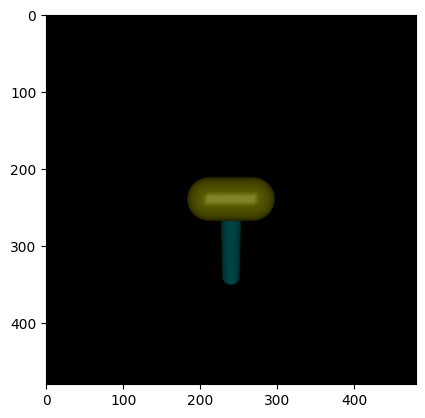

In [6]:
env_test = Normalize(Summaries(InvertedPendulumEnv(render_mode="single_rgb_array")))
seed = 1
env_test.seed(seed)
env_test.action_space.seed(seed)
env_test.observation_space.seed(seed)
obs = env_test.reset(seed=seed)
plt.imshow(env_test.render())

model_name = 'model_10000 (4).pth' # you can change it
model_path = f'./model_zoo/{model_name}'
#model_path = f'/content/{model_name}'
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model_test = Net(env_test.observation_space.shape[0], env_test.action_space.shape[0])
model_test.load_state_dict(torch.load(model_path, map_location=device))
policy_test = Policy(model_test)
writer = SummaryWriter()

In [7]:
%load_ext tensorboard

%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [8]:
images = []

for i in range(3000):
    action = policy_test.act(obs)["actions"]
    obs, r, d, _, _ = env_test.step(action)
    writer.add_scalar("x/step", obs[0], i)
    writer.add_scalar("theta/step", obs[1], i)
    writer.add_scalar("force/step", action[0], i)
    writer.add_scalar("reward/step", r, i)
    images.append(env_test.render())

writer.flush()
writer.close()

imageio.mimsave(f'videos/video_test_{model_name[:-4]}.gif', [np.array(img) for i, img in enumerate(images)], fps=30)

/usr/local/lib/python3.10/dist-packages/imageio/plugins/pillow.py:390: DeprecationWarning: The keyword `fps` is no longer supported. Use `duration`(in ms) instead, e.g. `fps=50` == `duration=20` (1000 * 1/50).
  warnings.warn(


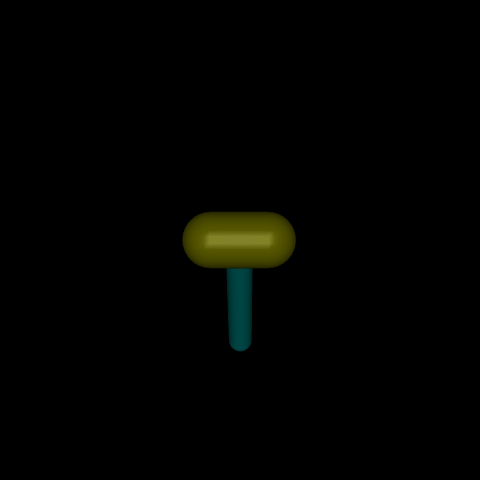

In [13]:
from IPython.display import Image

Image(url='...')  # external
fname = f'videos/video_test_{model_name[:-4]}.gif'
Image(open(fname, 'rb').read())  # local